# The purpose of this notebook is to model all features to (linear) protest target

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import Ridge, Lasso, ElasticNet, LinearRegression, QuantileRegressor, LogisticRegression
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier, ExtraTreeRegressor, ExtraTreeClassifier
from sklearn.ensemble import GradientBoostingRegressor, GradientBoostingClassifier, RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import GridSearchCV, train_test_split, KFold, StratifiedKFold
from xgboost import XGBRegressor, XGBClassifier
from sklearn.metrics import root_mean_squared_error, r2_score, recall_score, accuracy_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

import lightgbm as lgb
from catboost import CatBoostRegressor, CatBoostClassifier
from imblearn.over_sampling import SMOTE

In [3]:

# Load the dataset
df = pd.read_csv('../../02_dataset/merged_df.csv')

df.drop('Unnamed: 0', axis=1, inplace=True)

#narrow df only to that containing protest data, remove also countries with no features data

df= df[(df['Year']>1989) & (df['Year']<2021)]
df.dropna(subset='yprotest', inplace=True)
df.dropna(subset='ISO3_code', inplace=True)



In [4]:
df.columns

Index(['ISO3_code', 'Year', 'pt_gdp_agriculture', 'oil_rent',
       'democracy_polity', 'gdp', 'country', 'ethnic_fractionation_index',
       'mean_temp', 'yearly_avg_rainfall', 'rainfall_var_t',
       'rainfall_var_t_1', 'gdp_g', 'rainfall_diff_from_mean_norm',
       'n_below_rainfall', 'oil_prod', 'agricultural', 'low_oil_high_agr',
       'cum_rainfall_diff', 'mean_temp_t', 'mean_temp_t_1', 'gdp_percap',
       'gdp_percap_pchange', 'gdp_pchange', 'unemp_rate', 'unemp_rate_pchange',
       'gini', 'gini_pchange', 'population', 'participants', 'number_events',
       'yprotest', 'protest_fraction'],
      dtype='object')

In [5]:
# Grab all features except for select couple 

exclude = ['Year', 'ISO3_code', 'country', 'oil_prod', 'agricultural', 'low_oil_high_agr', \
           'protest_fraction', 'participants'] #excluding the last two because we wouldn't normally have that info
target_columns = ['number_events', 'yprotest'] #this can be modified. But probably this two have the best results so far. 
features = [col for col in df.columns if col not in exclude and col not in target_columns] 

print(features)

['pt_gdp_agriculture', 'oil_rent', 'democracy_polity', 'gdp', 'ethnic_fractionation_index', 'mean_temp', 'yearly_avg_rainfall', 'rainfall_var_t', 'rainfall_var_t_1', 'gdp_g', 'rainfall_diff_from_mean_norm', 'n_below_rainfall', 'cum_rainfall_diff', 'mean_temp_t', 'mean_temp_t_1', 'gdp_percap', 'gdp_percap_pchange', 'gdp_pchange', 'unemp_rate', 'unemp_rate_pchange', 'gini', 'gini_pchange', 'population']


In [6]:
# previously shown that gdp_g and gdp_pchange basically the same, gdp_percap, gdp_percap_pchange also related to gdp_g, so drop all these features, except for gdp and gdp_g
# gini index too many missing, not useful  
to_remove = ['gdp_percap', 'gdp_percap_pchange', 'gdp_pchange', 'gini', 'gini_pchange']
features = [f for f in features if f not in to_remove]

In [7]:
df[features].isna().any()


pt_gdp_agriculture              False
oil_rent                        False
democracy_polity                False
gdp                             False
ethnic_fractionation_index      False
mean_temp                       False
yearly_avg_rainfall             False
rainfall_var_t                  False
rainfall_var_t_1                False
gdp_g                           False
rainfall_diff_from_mean_norm    False
n_below_rainfall                False
cum_rainfall_diff               False
mean_temp_t                     False
mean_temp_t_1                   False
unemp_rate                      False
unemp_rate_pchange              False
population                      False
dtype: bool

In [8]:
# create train, test
df_train, df_test = train_test_split(df, test_size=0.2)

## Models to predict number events

### Reduce # of features using PCA?

In [9]:
pca_x =np.linspace(1,len(features))
pca_x.shape

(50,)

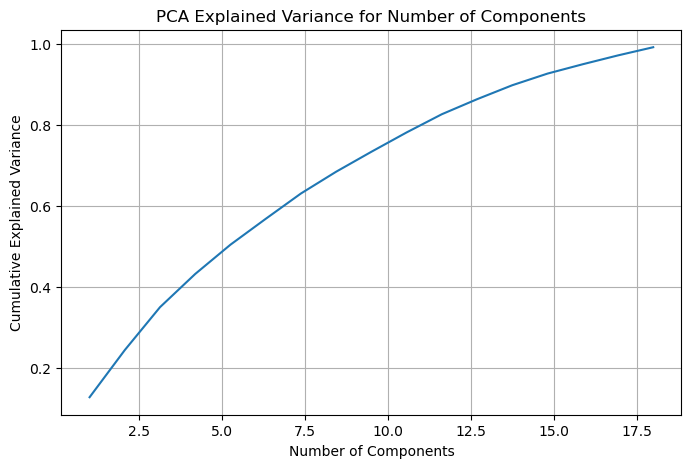

In [10]:
max_component = len(features)
pca_x =np.linspace(1,len(features),len(features)-1)
pca_y =[]

for i in range(1, max_component):
    pca = Pipeline([("scale", StandardScaler()), ("pca", PCA(n_components=i))])
    pca.fit(df_train[features])
    var = pca[1].explained_variance_ratio_.cumsum()
    
    # Get cum sum of variance ratio for plotting later explained variance ratio
    pca_y.append(var[-1])

plt.figure(figsize=(8, 5))
plt.plot(pca_x, pca_y)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('PCA Explained Variance for Number of Components')
plt.grid(True)
plt.show()

In [10]:
# Not sure if worth doing the PCA. Seems like didn't successfully reduce the dimensionality 

## Cross validation

In [15]:
# create all the different models to be tested
# start with default models and compare which are best
lr = LinearRegression()
ridge = Pipeline([('scale', StandardScaler()), ('ridge', Ridge())])
lasso = Pipeline([('scale', StandardScaler()), ('lasso', Lasso())])
qr = QuantileRegressor()
en = ElasticNet()
lgbm = lgb.LGBMRegressor()
rf = RandomForestRegressor()
dt = DecisionTreeRegressor()
et = ExtraTreeRegressor()
catb = CatBoostRegressor()
gb = GradientBoostingRegressor()
xgb = XGBRegressor(learning_rate = 0.1, max_depth= 3, n_estimators= 100, random_state=42)

model_l= [lr, ridge, lasso, qr, en, lgbm, rf, dt, et, catb, gb, xgb]


In [16]:
# create cv with ksplit
kfold = KFold(n_splits= 5,
              shuffle= True,
              random_state=42)

In [17]:
rmses= np.zeros((len(model_l), 5))
r2s = np.zeros((len(model_l), 5))

i=0
for train_index, test_index in kfold.split(df_train):
    df_tt = df_train.iloc[train_index]
    df_ho = df_train.iloc[test_index]
    
    for m in model_l:
        m.fit(df_tt[features], df_tt['number_events'])
        rmses[model_l.index(m), i] = root_mean_squared_error(df_ho['number_events'], m.predict(df_ho[features]))
        r2s[model_l.index(m),i] = r2_score(df_ho['number_events'], m.predict(df_ho[features]))

    i += 1

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000431 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 2358, number of used features: 18
[LightGBM] [Info] Start training from score 2.986005
Learning rate set to 0.046886
0:	learn: 5.9406802	total: 1.86ms	remaining: 1.86s
1:	learn: 5.9215610	total: 3.76ms	remaining: 1.88s
2:	learn: 5.9030778	total: 5.49ms	remaining: 1.82s
3:	learn: 5.8840554	total: 7.17ms	remaining: 1.79s
4:	learn: 5.8402361	total: 8.82ms	remaining: 1.75s
5:	learn: 5.8174159	total: 10.2ms	remaining: 1.69s
6:	learn: 5.7983487	total: 11.8ms	remaining: 1.67s
7:	learn: 5.7824741	total: 13.1ms	remaining: 1.62s
8:	learn: 5.7650124	total: 14.6ms	remaining: 1.6s
9:	learn: 5.7365396	total: 16.2ms	remaining: 1.6s
10:	learn: 5.7177165	total: 17.8ms	remaining: 1.6s
11:	learn: 5.7023478	total: 19.5ms	remaining: 1.6s
12:	learn: 5.672097

In [ ]:
print('RMSE values: ', rmses.mean(axis=1))
print('R2 scores: ', r2s.mean(axis=1))

#in terms of rmses - the best (lowest) are: lgbm, catboost, randomforest
#in terms of R2 values - the best (highest) are: lgbm, catboost, randomforest
# the two metrics agree, try to tune parameters of the top three models

model_l= [lr, ridge, lasso, qr, en, lgbm, rf, dt, et, catb, gb, xgb]


RMSE values:  [5.71084483 5.71082192 5.83086199 5.97234858 5.70084053 5.31449431
 5.57094491 7.47146622 7.41014518 5.43692998 6.11015206 5.85919934]
R2 scores:  [ 0.04851772  0.04852596  0.0071219  -0.04248616  0.05245205  0.17224892
  0.08088451 -0.72856102 -0.73566437  0.12694681 -0.12592937 -0.05046753]


In [19]:
# Finding best params for random forest
grid_rf = GridSearchCV(RandomForestRegressor(),param_grid= {'max_depth':range(1,16),
                                                            'n_estimators':[100,300,500],
                                                            'random_state':[42]},
                                                            scoring = 'neg_root_mean_squared_error',
                                                            cv=5)
grid_rf.fit(df_train[features], df_train['number_events'])

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'max_depth': range(1, 16),
                         'n_estimators': [100, 300, 500],
                         'random_state': [42]},
             scoring='neg_root_mean_squared_error')

In [20]:
print(grid_rf.best_params_, grid_rf.best_score_)
feature_importance_df = pd.DataFrame({
    'Feature': features,  # List of feature names
    'Importance': grid_rf.best_estimator_.feature_importances_
})

# Sort the features by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by="Importance", ascending=False)

# Reset index for better readability
feature_importance_df.reset_index(drop=True, inplace=True)

# Display the DataFrame
print(feature_importance_df)

{'max_depth': 14, 'n_estimators': 100, 'random_state': 42} -5.234934091751597
                         Feature  Importance
0              cum_rainfall_diff    0.169040
1                     population    0.107934
2             pt_gdp_agriculture    0.079016
3                            gdp    0.069668
4                          gdp_g    0.066709
5               rainfall_var_t_1    0.059354
6                      mean_temp    0.057098
7                     unemp_rate    0.052438
8     ethnic_fractionation_index    0.050311
9                 rainfall_var_t    0.048713
10           yearly_avg_rainfall    0.046331
11                 mean_temp_t_1    0.035684
12                      oil_rent    0.031363
13            unemp_rate_pchange    0.031351
14  rainfall_diff_from_mean_norm    0.030841
15              democracy_polity    0.028716
16                   mean_temp_t    0.023986
17              n_below_rainfall    0.011445


In [21]:
grid_lgbm = GridSearchCV(lgb.LGBMRegressor(), 
                         param_grid= {'max_depth':range(1,11),
                                    'learning_rate':[0.01, 0.1, 1],
                                    'n_estimators': [100,500],
                                    'random_state':[42]},
                                    scoring='neg_root_mean_squared_error',
                                    cv=5)
grid_lgbm.fit(df_train[features], df_train['number_events'])

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000462 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4113
[LightGBM] [Info] Number of data points in the train set: 2358, number of used features: 18
[LightGBM] [Info] Start training from score 2.877863
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

GridSearchCV(cv=5, estimator=LGBMRegressor(),
             param_grid={'learning_rate': [0.01, 0.1, 1],
                         'max_depth': range(1, 11), 'n_estimators': [100, 500],
                         'random_state': [42]},
             scoring='neg_root_mean_squared_error')

In [22]:
print(grid_lgbm.best_params_, grid_lgbm.best_score_)

{'learning_rate': 0.01, 'max_depth': 8, 'n_estimators': 500, 'random_state': 42} -5.292149424439479


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000443 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4131
[LightGBM] [Info] Number of data points in the train set: 2948, number of used features: 18
[LightGBM] [Info] Start training from score 2.964043
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

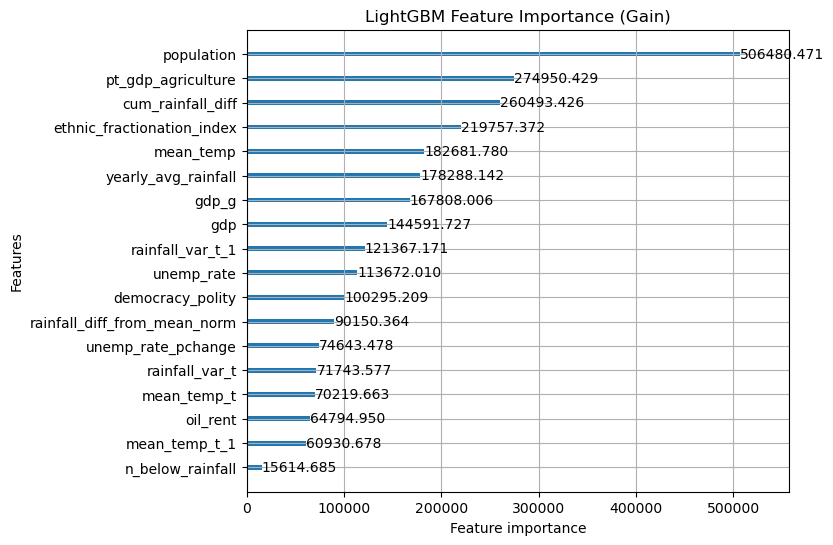

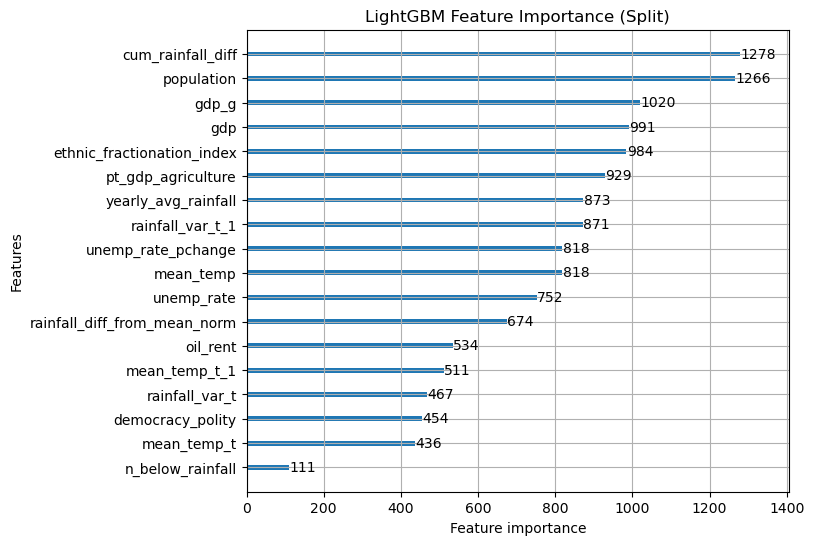

In [74]:
model = lgb.LGBMRegressor(learning_rate=0.01, max_depth= 8, n_estimators=500, random_state=42).fit(df_train[features], df_train['number_events'])

lgb.plot_importance(model, importance_type="gain", figsize=(7,6), title="LightGBM Feature Importance (Gain)")
lgb.plot_importance(model, importance_type="split", figsize=(7,6), title="LightGBM Feature Importance (Split)")
plt.show()

In [23]:
grid_cat = GridSearchCV(CatBoostRegressor(), param_grid= {'max_depth':range(1,11),
                                    'learning_rate':[0.01, 0.1, 1],
                                    'n_estimators': [100,500],
                                    'random_state':[42]},
                                    scoring = 'neg_root_mean_squared_error',
                                    cv=5)
grid_cat.fit(df_train[features], df_train['number_events'])

0:	learn: 5.3805372	total: 627us	remaining: 62.1ms
1:	learn: 5.3774045	total: 1.32ms	remaining: 64.9ms
2:	learn: 5.3749718	total: 1.76ms	remaining: 56.8ms
3:	learn: 5.3718993	total: 2.19ms	remaining: 52.5ms
4:	learn: 5.3692936	total: 2.61ms	remaining: 49.6ms
5:	learn: 5.3671564	total: 3.09ms	remaining: 48.5ms
6:	learn: 5.3642299	total: 3.58ms	remaining: 47.5ms
7:	learn: 5.3620118	total: 4ms	remaining: 46ms
8:	learn: 5.3591736	total: 4.43ms	remaining: 44.8ms
9:	learn: 5.3563768	total: 4.94ms	remaining: 44.5ms
10:	learn: 5.3536311	total: 5.29ms	remaining: 42.8ms
11:	learn: 5.3509519	total: 5.61ms	remaining: 41.2ms
12:	learn: 5.3484765	total: 5.94ms	remaining: 39.7ms
13:	learn: 5.3465592	total: 6.26ms	remaining: 38.5ms
14:	learn: 5.3445873	total: 6.61ms	remaining: 37.5ms
15:	learn: 5.3421709	total: 6.93ms	remaining: 36.4ms
16:	learn: 5.3401180	total: 7.25ms	remaining: 35.4ms
17:	learn: 5.3380885	total: 7.58ms	remaining: 34.5ms
18:	learn: 5.3356481	total: 7.95ms	remaining: 33.9ms
19:	learn

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostRegressor object at 0x000001A673E7B440>,
             param_grid={'learning_rate': [0.01, 0.1, 1],
                         'max_depth': range(1, 11), 'n_estimators': [100, 500],
                         'random_state': [42]},
             scoring='neg_root_mean_squared_error')

In [24]:
print(grid_cat.best_params_, grid_cat.best_score_)
feature_importance_df = pd.DataFrame({
    'Feature': features,  # List of feature names
    'Importance': grid_cat.best_estimator_.get_feature_importance()
})

# Sort the features by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Reset index for better readability
feature_importance_df.reset_index(drop=True, inplace=True)

# Display the DataFrame
print(feature_importance_df)

{'learning_rate': 0.1, 'max_depth': 9, 'n_estimators': 500, 'random_state': 42} -5.17617998852327
                         Feature  Importance
0                     population   10.151432
1              cum_rainfall_diff    8.613891
2                            gdp    6.991088
3                          gdp_g    6.674763
4     ethnic_fractionation_index    6.568484
5                      mean_temp    5.956380
6             pt_gdp_agriculture    5.880894
7                 rainfall_var_t    5.538936
8               rainfall_var_t_1    5.476843
9             unemp_rate_pchange    5.326918
10                      oil_rent    4.973551
11           yearly_avg_rainfall    4.766526
12                   mean_temp_t    4.682575
13                    unemp_rate    4.680424
14  rainfall_diff_from_mean_norm    4.339251
15                 mean_temp_t_1    4.338332
16              democracy_polity    4.105095
17              n_below_rainfall    0.934618


In [76]:
# compare the top three models after hyperparameter tuning
lgbm_t = lgb.LGBMRegressor(max_depth=8, learning_rate=0.01, n_estimators=500)
rf_t = RandomForestRegressor(n_estimators= 100, max_depth = 14, random_state = 42)
catb_t = CatBoostRegressor(max_depth=9, learning_rate=0.1, n_estimators=500, random_state=42)


model_t_l= [lgbm_t, rf_t, catb_t]

In [77]:
rmses= np.zeros((len(model_t_l), 5))
r2s = np.zeros((len(model_t_l), 5))

i=0
for train_index, test_index in kfold.split(df_train):
    df_tt = df_train.iloc[train_index]
    df_ho = df_train.iloc[test_index]
    
    for m in model_t_l:
        m.fit(df_tt[features], df_tt['number_events'])
        rmses[model_t_l.index(m), i] = root_mean_squared_error(df_ho['number_events'], m.predict(df_ho[features]))
        r2s[model_t_l.index(m),i] = r2_score(df_ho['number_events'], m.predict(df_ho[features]))

    i += 1
print()
print('RMSE values: ', rmses.mean(axis=1))
print('R2 scores: ', r2s.mean(axis=1))

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000651 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 2358, number of used features: 18
[LightGBM] [Info] Start training from score 2.986005
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

## Plotting against Test Set

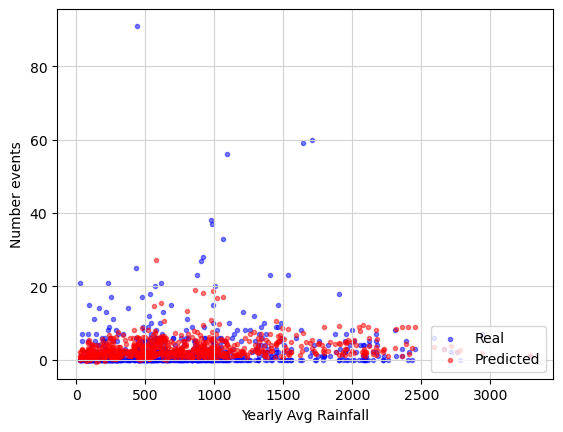

In [78]:
#plot agreement - use catboost - highest r2 value =0.23
x_axis = df_test.yearly_avg_rainfall

predictions = lgbm_t.predict(df_test[features])

# Build scatterplot
plt.scatter(x_axis, df_test['number_events'], c = 'b', alpha = 0.5, marker = '.', label = 'Real')
plt.scatter(x_axis, predictions, c = 'r', alpha = 0.5, marker = '.', label = 'Predicted')
plt.xlabel('Yearly Avg Rainfall')
plt.ylabel('Number events')
plt.grid(color = '#D3D3D3', linestyle = 'solid')
plt.legend(loc = 'lower right')
plt.show()

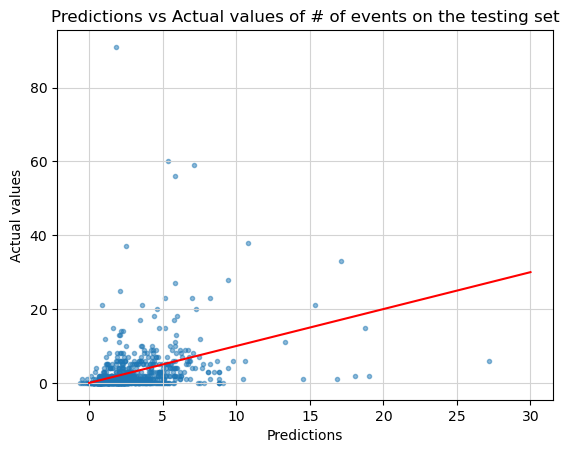

In [79]:
x = np.linspace(0,30,30)
y = x
plt.scatter(predictions, df_test['number_events'], alpha = 0.5, marker ='.')
plt.plot(x, y, c='r')
plt.xlabel('Predictions')
plt.ylabel('Actual values')
plt.title('Predictions vs Actual values of # of events on the testing set')
plt.grid(color = '#D3D3D3', linestyle = 'solid')
plt.show()

#model not so good when predicting large number of events, but may make sense because those are rarer


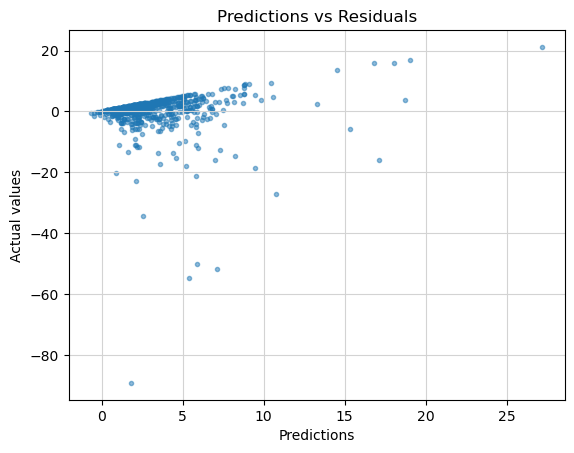

In [81]:
#plotting residuals vs predictions - lots of underestimations in # of events?
resids = predictions - df_test['number_events']
plt.scatter(predictions, resids, alpha = 0.5, marker ='.')
plt.xlabel('Predictions')
plt.ylabel('Actual values')
plt.title('Predictions vs Residuals')
plt.grid(color = '#D3D3D3', linestyle = 'solid')
plt.show()

# Classification models for y/n protest

## Balancing dataset

In [83]:
counts = df["yprotest"].value_counts()

# Identify minority class size and label
minority_class_size = counts.min()
minority_class_label = counts.idxmin()
majority_class_label = counts.idxmax()

print(f"Minority class label: {minority_class_label}, Size: {minority_class_size}")
print(f"Majority class label: {majority_class_label}, Size: {counts.max()}")
print("-" * 30)

# Get the pandas Index object for rows corresponding to each class
minority_indices = df.index[df['yprotest'] == minority_class_label]
majority_indices = df.index[df['yprotest'] == majority_class_label]

# Randomly sample the *indices* of the majority class using numpy
# Create a random number generator instance for reproducibility
rng = np.random.default_rng(seed=42)
sampled_majority_indices_array = rng.choice(
    majority_indices.to_numpy(), # Convert Index to numpy array for choice
    size=minority_class_size,
    replace=False # Ensure we don't pick the same index twice
)

# Convert the numpy array of sampled indices back to a pandas Index
sampled_majority_indices = pd.Index(sampled_majority_indices_array)

print(f"Number of majority indices sampled: {len(sampled_majority_indices)}")
print(f"Number of minority indices: {len(minority_indices)}")
print("-" * 30)

# Combine the minority indices and the sampled majority indices
combined_indices = minority_indices.union(sampled_majority_indices)

# Select rows from the original DataFrame using the combined indices
df_balanced = df.loc[combined_indices]

print(counts)
# If using method above, ends up with smaller dataset?

Minority class label: 0.0, Size: 1428
Majority class label: 1.0, Size: 2258
------------------------------
Number of majority indices sampled: 1428
Number of minority indices: 1428
------------------------------
yprotest
1.0    2258
0.0    1428
Name: count, dtype: int64


# Cross validation

In [9]:
bal_kfold = StratifiedKFold(n_splits=5,
                           shuffle=True,
                           random_state=216)

In [10]:
# create default models

log = LogisticRegression(penalty= None, max_iter=10000)
lgbm = lgb.LGBMClassifier() 
rf = RandomForestClassifier()
catb = CatBoostClassifier()
xgb = XGBClassifier()

model_l= [log, lgbm, rf, catb, xgb]


In [11]:
#run stratified k fold, loop over models and create smote under each kfold
smote_accs = np.zeros((len(model_l), 5))
smote_recall = np.zeros((len(model_l), 5))
smote_fnr = np.zeros((len(model_l), 5))

i=0
for train_index, test_index in bal_kfold.split(df_train, df_train.yprotest):
    df_tt = df_train.iloc[train_index]
    df_ho = df_train.iloc[test_index]
    
    #create pipeline for smote resampling on the kfold training set
    for m in model_l:
        smote = Pipeline([('over', SMOTE()), ('model', m)])

        X, y = smote[0].fit_resample(df_tt[features].values, df_tt.yprotest.values)
        #fit the data
        smote[1].fit(X, y)
        #grab predictions
        pred = smote[1].predict(df_ho[features].values)

        #store metrics
        smote_accs[model_l.index(m), i] = accuracy_score(df_ho.yprotest.values, pred)
        smote_recall[model_l.index(m), i] = recall_score(df_ho.yprotest.values, pred)
        # grab confusion matrix values
        FN = confusion_matrix(df_ho.yprotest.values, pred)[1,0]
        TP = confusion_matrix(df_ho.yprotest.values, pred)[1,1]
        smote_fnr[model_l.index(m), i] = np.round(FN/(TP+FN),4)

    i += 1

[LightGBM] [Info] Number of positive: 1435, number of negative: 1435
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4576
[LightGBM] [Info] Number of data points in the train set: 2870, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Learning rate set to 0.01616
0:	learn: 0.6896141	total: 158ms	remaining: 2m 38s
1:	learn: 0.6866039	total: 167ms	remaining: 1m 23s
2:	learn: 0.6831513	total: 174ms	remaining: 57.7s
3:	learn: 0.6801185	total: 179ms	remaining: 44.6s
4:	learn: 0.6773701	total: 183ms	remaining: 36.5s
5:	learn: 0.6740982	total: 187ms	remaining: 30.9s
6:	learn: 0.6712639	total: 190ms	remaining: 26.9s
7:	learn: 0.6688999	total: 192ms	remaining: 23.8s
8:	learn: 0.6658116	total: 194ms	remaining: 21.4s
9:	learn: 0.6630989

In [ ]:
print('acc values: ', smote_accs.mean(axis=1))
print('recall scores: ', smote_recall.mean(axis=1))
print('fnr scores: ', smote_fnr.mean(axis=1))

# logistic regression has great values, but could be due to predicting everything as 1. accuracy is oddly close to actual proportions in training set
# others are about the same, lgbm/catboost is best, but can try tuning and compare again

acc values:  [0.61465109 0.7042065  0.71811516 0.70793876 0.68759057]
recall scores:  [0.99554318 0.7670111  0.76309737 0.7681253  0.7508411 ]
fnr scores:  [0.00446 0.23298 0.23692 0.23188 0.24914]


In [13]:
# compare performance when not using smote
#run stratified k fold, loop over models and create smote under each kfold
accs = np.zeros((len(model_l), 5))
recall = np.zeros((len(model_l), 5))
fnr = np.zeros((len(model_l), 5))

i=0
for train_index, test_index in bal_kfold.split(df_train, df_train.yprotest):
    df_tt = df_train.iloc[train_index]
    df_ho = df_train.iloc[test_index]
    
    #create pipeline for smote resampling on the kfold training set
    for m in model_l:
        m.fit(df_tt[features].values, df_tt.yprotest.values)
        #grab predictions
        pred = m.predict(df_ho[features].values)

        #store metrics
        accs[model_l.index(m), i] = accuracy_score(df_ho.yprotest.values, pred)
        recall[model_l.index(m), i] = recall_score(df_ho.yprotest.values, pred)
        # grab confusion matrix values
        FN = confusion_matrix(df_ho.yprotest.values, pred)[1,0]
        TP = confusion_matrix(df_ho.yprotest.values, pred)[1,1]
        fnr[model_l.index(m), i] = np.round(FN/(TP+FN),4)

    i += 1

[LightGBM] [Info] Number of positive: 1435, number of negative: 923
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000374 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 2358, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.608567 -> initscore=0.441291
[LightGBM] [Info] Start training from score 0.441291
Learning rate set to 0.01486
0:	learn: 0.6894285	total: 4.63ms	remaining: 4.63s
1:	learn: 0.6863234	total: 8.69ms	remaining: 4.34s
2:	learn: 0.6828272	total: 11.5ms	remaining: 3.83s
3:	learn: 0.6787630	total: 13.6ms	remaining: 3.38s
4:	learn: 0.6758611	total: 15.6ms	remaining: 3.1s
5:	learn: 0.6729772	total: 17.9ms	remaining: 2.96s
6:	learn: 0.6699913	total: 19.9ms	remaining: 2.82s
7:	learn: 0.6667966	total: 21.8ms	remaining: 2.7s
8:	learn: 0.6638481	total: 24ms	remaining: 2.64s
9:	learn: 0.6617715	total: 2

In [ ]:
print('acc values: ', accs.mean(axis=1))
print('recall scores: ', recall.mean(axis=1))
print('fnr scores: ', fnr.mean(axis=1))

#performance actually ended up better without resampling in terms of recall and fnr
#focus on lgbm, rf, and catboost and tune hyperparameters- compare these ones

acc values:  [0.61058214 0.71336422 0.72862709 0.71912808 0.70012892]
recall scores:  [1.         0.8093696  0.83890696 0.8450491  0.79376294]
fnr scores:  [0.      0.19064 0.1611  0.15496 0.20624]


In [47]:
#grid search for ensemble/boosting methods

grid_rf = GridSearchCV(RandomForestClassifier(),param_grid= {'max_depth':range(1,11),
                                                            'n_estimators':[100,300,500],
                                                            'random_state':[42]},
                                                            scoring = 'neg_root_mean_squared_error',
                                                            cv=5)
grid_rf.fit(df_train[features], df_train['yprotest'])


GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': range(1, 11),
                         'n_estimators': [100, 300, 500],
                         'random_state': [42]},
             scoring='neg_root_mean_squared_error')

In [48]:
print(grid_rf.best_params_, grid_rf.best_score_)
feature_importance_df = pd.DataFrame({
    'Feature': features,  # List of feature names
    'Importance': grid_rf.best_estimator_.feature_importances_
})

feature_importance_df = feature_importance_df.sort_values(by="Importance", ascending=False)
feature_importance_df.reset_index(drop=True, inplace=True)
print(feature_importance_df)

{'max_depth': 10, 'n_estimators': 500, 'random_state': 42} -0.523165032377707
                         Feature  Importance
0                     population    0.119266
1                            gdp    0.080641
2            yearly_avg_rainfall    0.077282
3               democracy_polity    0.075449
4             pt_gdp_agriculture    0.073792
5                      mean_temp    0.072208
6     ethnic_fractionation_index    0.055956
7                     unemp_rate    0.055533
8              cum_rainfall_diff    0.053016
9                       oil_rent    0.048280
10                         gdp_g    0.047193
11            unemp_rate_pchange    0.042669
12                   mean_temp_t    0.039358
13  rainfall_diff_from_mean_norm    0.038307
14                 mean_temp_t_1    0.037666
15                rainfall_var_t    0.036310
16              rainfall_var_t_1    0.033988
17              n_below_rainfall    0.013087


In [49]:
grid_cat = GridSearchCV(CatBoostClassifier(), param_grid= {'max_depth':range(1,11),
                                    'learning_rate':[0.01, 0.1, 1],
                                    'n_estimators': [100,300,500],
                                    'random_state':[42]},
                                    scoring = 'neg_root_mean_squared_error',
                                    cv=5)
grid_cat.fit(df_train[features], df_train['yprotest'])

0:	learn: 0.6923289	total: 622us	remaining: 61.6ms
1:	learn: 0.6914365	total: 1.13ms	remaining: 55.3ms
2:	learn: 0.6906197	total: 1.41ms	remaining: 45.5ms
3:	learn: 0.6897988	total: 1.73ms	remaining: 41.4ms
4:	learn: 0.6890581	total: 2.09ms	remaining: 39.8ms
5:	learn: 0.6885040	total: 2.45ms	remaining: 38.4ms
6:	learn: 0.6876600	total: 2.79ms	remaining: 37.1ms
7:	learn: 0.6869180	total: 3.09ms	remaining: 35.6ms
8:	learn: 0.6861420	total: 3.38ms	remaining: 34.1ms
9:	learn: 0.6854484	total: 3.69ms	remaining: 33.2ms
10:	learn: 0.6847402	total: 3.93ms	remaining: 31.8ms
11:	learn: 0.6840163	total: 4.25ms	remaining: 31.1ms
12:	learn: 0.6832393	total: 4.54ms	remaining: 30.4ms
13:	learn: 0.6825752	total: 4.87ms	remaining: 29.9ms
14:	learn: 0.6818749	total: 5.16ms	remaining: 29.2ms
15:	learn: 0.6812171	total: 5.46ms	remaining: 28.7ms
16:	learn: 0.6804735	total: 5.78ms	remaining: 28.2ms
17:	learn: 0.6798572	total: 6.1ms	remaining: 27.8ms
18:	learn: 0.6793312	total: 6.46ms	remaining: 27.5ms
19:	l

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x000001CD2F3B52E0>,
             param_grid={'learning_rate': [0.01, 0.1, 1],
                         'max_depth': range(1, 11),
                         'n_estimators': [100, 300, 500],
                         'random_state': [42]},
             scoring='neg_root_mean_squared_error')

In [50]:
print(grid_cat.best_params_, grid_cat.best_score_)
feature_importance_df = pd.DataFrame({
    'Feature': features,  # List of feature names
    'Importance': grid_cat.best_estimator_.get_feature_importance()
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)
feature_importance_df.reset_index(drop=True, inplace=True)
print(feature_importance_df)

{'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 500, 'random_state': 42} -0.5282790686388043
                         Feature  Importance
0                     population   12.643516
1               democracy_polity   10.931540
2             pt_gdp_agriculture    8.307794
3                      mean_temp    7.923088
4                     unemp_rate    6.748568
5                       oil_rent    6.740610
6                            gdp    6.415461
7            yearly_avg_rainfall    6.329864
8     ethnic_fractionation_index    5.698451
9              cum_rainfall_diff    4.849860
10            unemp_rate_pchange    4.542711
11                         gdp_g    4.335087
12  rainfall_diff_from_mean_norm    2.932787
13                   mean_temp_t    2.867776
14                 mean_temp_t_1    2.514824
15              rainfall_var_t_1    2.396717
16                rainfall_var_t    2.322004
17              n_below_rainfall    1.499342


In [51]:
grid_lgbm = GridSearchCV(lgb.LGBMClassifier(), 
                         param_grid= {'max_depth':range(1,11),
                                    'learning_rate':[0.01, 0.1, 1],
                                    'n_estimators': [100,500],
                                    'random_state':[42]},
                                    scoring='neg_root_mean_squared_error',
                                    cv=5)
grid_lgbm.fit(df_train[features], df_train['yprotest'])
print(grid_lgbm.best_params_, grid_lgbm.best_score_)

[LightGBM] [Info] Number of positive: 1435, number of negative: 923
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000429 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 2358, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.608567 -> initscore=0.441291
[LightGBM] [Info] Start training from score 0.441291
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

{'learning_rate': 0.01, 'max_depth': 9, 'n_estimators': 500, 'random_state': 42} -0.530278954763793
[LightGBM] [Info] Number of positive: 1794, number of negative: 1154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000571 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4129
[LightGBM] [Info] Number of data points in the train set: 2948, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.608548 -> initscore=0.441214
[LightGBM] [Info] Start training from score 0.441214
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spli

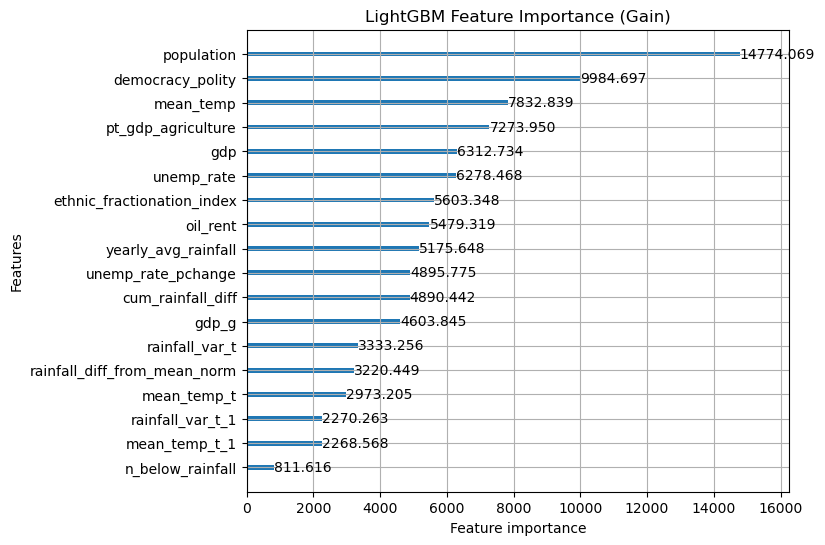

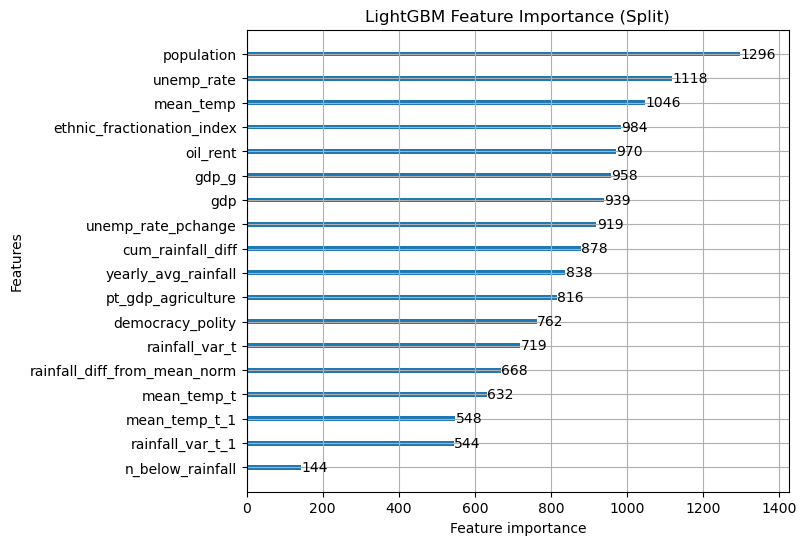

In [ ]:
# grabbing feature importance from lgbm model
model = lgb.LGBMClassifier(learning_rate=0.01, max_depth= 9, n_estimators=500, random_state=42).fit(df_train[features], df_train['yprotest'])

lgb.plot_importance(model, importance_type="gain", figsize=(7,6), title="LightGBM Feature Importance (Gain)")
lgb.plot_importance(model, importance_type="split", figsize=(7,6), title="LightGBM Feature Importance (Split)")
plt.show()

In [72]:
# create all the different classifications models to be tested, just take the top 4 models 

lgbm_t = lgb.LGBMClassifier(learning_rate=0.01, max_depth= 9, n_estimators=500, random_state=42)  
rf_t = RandomForestClassifier(n_estimators= 500, max_depth = 10, random_state = 42)
catb_t = CatBoostClassifier(learning_rate= 0.01, max_depth= 7, n_estimators= 500, random_state=42)

model_t_l= [lgbm_t, rf_t, catb_t]


In [73]:
#run stratified k fold, loop over models and create smote under each kfold
smote_accs = np.zeros((len(model_t_l), 5))
smote_recall = np.zeros((len(model_t_l), 5))
smote_fnr = np.zeros((len(model_t_l), 5))

i=0
for train_index, test_index in bal_kfold.split(df_train, df_train.yprotest):
    df_tt = df_train.iloc[train_index]
    df_ho = df_train.iloc[test_index]
    
    #create pipeline for smote resampling on the kfold training set
    for m in model_t_l:
        smote = Pipeline([('over', SMOTE()), ('model', m)])

        X, y = smote[0].fit_resample(df_tt[features].values, df_tt.yprotest.values)
        #fit the data
        smote[1].fit(X, y)
        #grab predictions
        pred = smote[1].predict(df_ho[features].values)

        #store metrics
        smote_accs[model_t_l.index(m), i] = accuracy_score(df_ho.yprotest.values, pred)
        smote_recall[model_t_l.index(m), i] = recall_score(df_ho.yprotest.values, pred)
        # grab confusion matrix values
        FN = confusion_matrix(df_ho.yprotest.values, pred)[1,0]
        TP = confusion_matrix(df_ho.yprotest.values, pred)[1,1]
        smote_fnr[model_t_l.index(m), i] = np.round(FN/(TP+FN),4)

    i += 1

[LightGBM] [Info] Number of positive: 1435, number of negative: 1435
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000481 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4576
[LightGBM] [Info] Number of data points in the train set: 2870, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

In [74]:
print('acc values: ', smote_accs.mean(axis=1))
print('recall scores: ', smote_recall.mean(axis=1))
print('fnr scores: ', smote_fnr.mean(axis=1))

#comparable, but lgbm, catboost is the best

acc values:  [0.69673966 0.70522517 0.70250583]
recall scores:  [0.7592101  0.73857394 0.7524984 ]
fnr scores:  [0.2408  0.26144 0.24752]


In [75]:
#run model comparisons without smote

accs = np.zeros((len(model_t_l), 5))
recall = np.zeros((len(model_t_l), 5))
fnr = np.zeros((len(model_t_l), 5))

i=0
for train_index, test_index in bal_kfold.split(df_train, df_train.yprotest):
    df_tt = df_train.iloc[train_index]
    df_ho = df_train.iloc[test_index]
    
    #create pipeline for smote resampling on the kfold training set
    for m in model_t_l:
        m.fit(df_tt[features].values, df_tt.yprotest.values)

        #grab predictions
        pred = m.predict(df_ho[features].values)

        #store metrics
        accs[model_t_l.index(m), i] = accuracy_score(df_ho.yprotest.values, pred)
        recall[model_t_l.index(m), i] = recall_score(df_ho.yprotest.values, pred)
        # grab confusion matrix values
        FN = confusion_matrix(df_ho.yprotest.values, pred)[1,0]
        TP = confusion_matrix(df_ho.yprotest.values, pred)[1,1]
        fnr[model_t_l.index(m), i] = np.round(FN/(TP+FN),4)

    i += 1

[LightGBM] [Info] Number of positive: 1435, number of negative: 923
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000515 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4119
[LightGBM] [Info] Number of data points in the train set: 2358, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.608567 -> initscore=0.441291
[LightGBM] [Info] Start training from score 0.441291
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

In [76]:
print('acc values: ', accs.mean(axis=1))
print('recall scores: ', recall.mean(axis=1))
print('fnr scores: ', fnr.mean(axis=1))

#without smote, rf, catboost is the best, and performance is much higher, with lower fnr rates


acc values:  [0.72014848 0.72557279 0.71098961]
recall scores:  [0.8366801  0.87402312 0.85953222]
fnr scores:  [0.16332 0.12598 0.14048]


## Plotting against test set

In [ ]:
#comparing this against the test set

rf_t = RandomForestClassifier(n_estimators= 500, max_depth = 10)

rf_t.fit(df_train[features].values, df_train.yprotest.values)
pred = rf_t.predict(df_test[features].values)

acc = accuracy_score(df_test.yprotest.values, pred)
recall = recall_score(df_test.yprotest.values, pred)
cf_matrix = confusion_matrix(df_test.yprotest.values, pred)
FN = cf_matrix[1,0]
TP = cf_matrix[1,1]
fnr = np.round(FN/(TP+FN),4)

print(acc, recall, fnr)

0.7222222222222222 0.8426724137931034 0.1573


<Axes: >

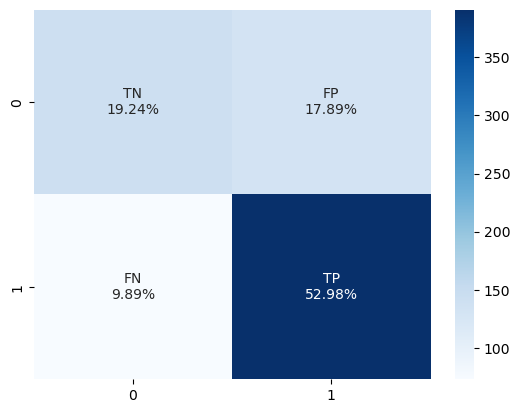

In [ ]:
group_names = ['TN', 'FP', 'FN', 'TP']
group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f"{v1}\n{v2}" for v1, v2 in
          zip(group_names,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

#  better than the model that only uses gdp features